## Importing Libraries

In [133]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier 
from sklearn.metrics import accuracy_score, roc_curve, auc, f1_score, confusion_matrix, classification_report
from sklearn import tree 
from sklearn.preprocessing import OneHotEncoder
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pandas as pd 
import numpy as np 
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.externals.six import StringIO  
# import pydoptplus
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import StandardScaler, MinMaxScaler, minmax_scale
np.random.seed(0)
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import precision_score, recall_score
import xgboost as xgb
import math
from sklearn.utils.multiclass import unique_labels
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
df4 = pd.read_csv('data/savant_data_4.csv')

In [3]:
df4.shape

(40000, 89)

In [4]:
df4.game_date.unique()

array(['2019-09-29', '2019-09-28', '2019-09-27', '2019-09-26',
       '2019-09-25', '2019-09-24', '2019-09-23', '2019-09-22',
       '2019-09-21', '2019-09-20', '2019-09-19', '2019-09-18',
       '2019-09-17', '2019-09-16', '2019-09-15', '2019-09-14',
       '2019-09-13', '2019-09-12', '2019-09-11', '2019-09-10',
       '2019-09-09', '2019-09-08', '2019-09-07', '2019-09-06',
       '2019-09-05', '2019-09-04', '2019-09-03', '2019-09-02',
       '2019-09-01', '2019-08-31', '2019-08-30', '2019-08-29',
       '2019-08-28', '2019-08-27', '2019-08-26', '2019-08-25',
       '2019-08-24', '2019-08-23', '2019-08-22', '2019-08-21',
       '2019-08-20', '2019-08-19', '2019-08-18', '2019-08-17',
       '2019-08-16', '2019-08-15', '2019-08-14', '2019-08-13',
       '2019-08-12', '2019-08-11', '2019-08-10', '2019-08-09',
       '2019-08-08', '2019-08-07', '2019-08-06', '2019-08-05',
       '2019-08-04', '2019-08-03', '2019-08-02', '2019-08-01',
       '2019-07-31', '2019-07-30', '2019-07-29', '2019-

In [5]:
df4.columns

Index(['pitch_type', 'game_date', 'release_speed', 'release_pos_x',
       'release_pos_z', 'player_name', 'batter', 'pitcher', 'events',
       'description', 'spin_dir', 'spin_rate_deprecated',
       'break_angle_deprecated', 'break_length_deprecated', 'zone', 'des',
       'game_type', 'stand', 'p_throws', 'home_team', 'away_team', 'type',
       'hit_location', 'bb_type', 'balls', 'strikes', 'game_year', 'pfx_x',
       'pfx_z', 'plate_x', 'plate_z', 'on_3b', 'on_2b', 'on_1b',
       'outs_when_up', 'inning', 'inning_topbot', 'hc_x', 'hc_y',
       'tfs_deprecated', 'tfs_zulu_deprecated', 'fielder_2', 'umpire', 'sv_id',
       'vx0', 'vy0', 'vz0', 'ax', 'ay', 'az', 'sz_top', 'sz_bot',
       'hit_distance_sc', 'launch_speed', 'launch_angle', 'effective_speed',
       'release_spin_rate', 'release_extension', 'game_pk', 'pitcher.1',
       'fielder_2.1', 'fielder_3', 'fielder_4', 'fielder_5', 'fielder_6',
       'fielder_7', 'fielder_8', 'fielder_9', 'release_pos_y',
       'estima

In [6]:
df4['spray_angle'] = ((df4['hc_x'] - 125.42) / (198.27 - df4['hc_y'])) * 180/math.pi*.75

In [7]:
df4[['spray_angle', 'hc_x', 'hc_y']].head()

,spray_angle,hc_x,hc_y
0,-17.388603,122.81,191.82
1,24.485046,216.49,38.44
2,-19.744987,84.42,109.04
3,43.660649,202.75,122.16
4,27.166506,179.58,112.60


In [8]:
df4.spray_angle.describe()

count    39835.000000
mean        -0.754343
std         67.256789
min     -11430.508013
25%        -19.988519
50%         -1.404625
75%         18.567896
max       3858.870750
Name: spray_angle, dtype: float64

In [9]:
import plotly.express as px

fig = px.scatter(df4, x="launch_speed", y="launch_angle", log_x=False, log_y = False,
                 hover_name="player_name", hover_data=None, color="events")

fig.show()

In [10]:
df4_rel = df4[['release_speed', 'release_pos_x',
       'release_pos_z', 'player_name', 'batter', 'pitcher', 'events',
       'zone',
       'stand', 'p_throws', 'type',
       'hit_location', 'balls', 'strikes', 'pfx_x',
       'pfx_z', 'plate_x', 'plate_z',
       'outs_when_up', 'inning', 'inning_topbot',
       'vx0', 'vy0', 'vz0', 'ax', 'ay', 'az', 'sz_top', 'sz_bot',
       'hit_distance_sc', 'launch_speed', 'launch_angle', 'effective_speed',
       'release_spin_rate', 'release_extension',  'release_pos_y',
        'at_bat_number', 'pitch_number', 'pitch_name',
       'if_fielding_alignment', 'of_fielding_alignment', 'spray_angle']]

In [11]:
df4_rel.shape

(40000, 42)

In [12]:
df4_rel

,release_speed,release_pos_x,release_pos_z,player_name,batter,pitcher,events,zone,stand,p_throws,...,effective_speed,release_spin_rate,release_extension,release_pos_y,at_bat_number,pitch_number,pitch_name,if_fielding_alignment,of_fielding_alignment,spray_angle
0,83.8,-0.9456,6.2833,Yonathan Daza,602074,607188,single,2.0,R,R,...,83.848,1988.0,5.802,54.6973,102,2,Slider,Standard,Standard,-17.388603
1,91.4,3.2415,5.8139,Dominic Smith,642086,594795,home_run,1.0,L,L,...,90.832,2383.0,6.302,54.1978,93,2,4-Seam Fastball,Strategic,Standard,24.485046
2,90.2,-2.1770,6.0649,Wilson Ramos,467092,461872,single,7.0,R,R,...,90.044,1985.0,6.356,54.1437,91,2,2-Seam Fastball,Standard,Standard,-19.744987
3,96.4,-2.5783,5.7329,Tyrone Taylor,621438,622075,double,4.0,R,R,...,97.857,2199.0,6.580,53.9193,85,4,4-Seam Fastball,Standard,Standard,43.660649
4,82.4,-0.1186,6.6827,David Fletcher,664058,606965,single,14.0,R,R,...,81.588,1811.0,5.858,54.6412,83,3,Changeup,Standard,Standard,27.166506
5,80.0,-1.2797,6.8814,Mike Yastrzemski,573262,548389,single,6.0,L,R,...,78.789,2789.0,5.593,54.9060,77,3,Knuckle Curve,Infield shift,Standard,-15.498656
6,89.1,1.9501,5.6016,Luis Guillorme,641645,460283,single,6.0,L,L,...,88.657,2129.0,6.158,54.3413,89,7,4-Seam Fastball,Standard,Strategic,-19.032655
7,94.0,-2.4140,4.9822,Ryan McMahon,641857,592865,single,4.0,L,R,...,94.305,2477.0,5.933,54.5663,83,6,4-Seam Fastball,Infield shift,Standard,-26.816507
8,92.9,-2.0679,6.1484,Rafael Ortega,542364,621141,single,4.0,L,R,...,93.588,2330.0,6.589,53.9104,87,3,4-Seam Fastball,Standard,Standard,24.962624
9,96.7,-1.7133,6.4048,Aledmys Diaz,649557,472610,double,6.0,R,R,...,96.079,2218.0,6.168,54.3317,79,1,4-Seam Fastball,Standard,Standard,2.647917


In [13]:
df4_features_and_target = df4_rel[['release_speed', 'release_pos_x',
       'release_pos_z', 'events',
       'zone',
       'stand', 'p_throws',
        'balls', 'strikes', 'pfx_x',
       'pfx_z', 'plate_x', 'plate_z',
       'outs_when_up', 'inning', 'inning_topbot',
       'vx0', 'vy0', 'vz0', 'ax', 'ay', 'az', 'sz_top', 'sz_bot',
     'launch_speed', 'launch_angle', 'effective_speed',
       'release_spin_rate', 'release_extension',  'release_pos_y',
     'at_bat_number', 'pitch_number', 'pitch_name',
       'if_fielding_alignment', 'of_fielding_alignment', 'spray_angle']]

In [14]:
df4_features_and_target.shape

(40000, 36)

In [15]:
df4_features_and_target

,release_speed,release_pos_x,release_pos_z,events,zone,stand,p_throws,balls,strikes,pfx_x,...,effective_speed,release_spin_rate,release_extension,release_pos_y,at_bat_number,pitch_number,pitch_name,if_fielding_alignment,of_fielding_alignment,spray_angle
0,83.8,-0.9456,6.2833,single,2.0,R,R,0,1,0.1308,...,83.848,1988.0,5.802,54.6973,102,2,Slider,Standard,Standard,-17.388603
1,91.4,3.2415,5.8139,home_run,1.0,L,L,1,0,0.7561,...,90.832,2383.0,6.302,54.1978,93,2,4-Seam Fastball,Strategic,Standard,24.485046
2,90.2,-2.1770,6.0649,single,7.0,R,R,0,1,-1.3797,...,90.044,1985.0,6.356,54.1437,91,2,2-Seam Fastball,Standard,Standard,-19.744987
3,96.4,-2.5783,5.7329,double,4.0,R,R,2,1,-0.7222,...,97.857,2199.0,6.580,53.9193,85,4,4-Seam Fastball,Standard,Standard,43.660649
4,82.4,-0.1186,6.6827,single,14.0,R,R,1,1,-1.6149,...,81.588,1811.0,5.858,54.6412,83,3,Changeup,Standard,Standard,27.166506
5,80.0,-1.2797,6.8814,single,6.0,L,R,1,1,0.6523,...,78.789,2789.0,5.593,54.9060,77,3,Knuckle Curve,Infield shift,Standard,-15.498656
6,89.1,1.9501,5.6016,single,6.0,L,L,3,2,0.7288,...,88.657,2129.0,6.158,54.3413,89,7,4-Seam Fastball,Standard,Strategic,-19.032655
7,94.0,-2.4140,4.9822,single,4.0,L,R,3,2,-0.4793,...,94.305,2477.0,5.933,54.5663,83,6,4-Seam Fastball,Infield shift,Standard,-26.816507
8,92.9,-2.0679,6.1484,single,4.0,L,R,1,1,-1.0968,...,93.588,2330.0,6.589,53.9104,87,3,4-Seam Fastball,Standard,Standard,24.962624
9,96.7,-1.7133,6.4048,double,6.0,R,R,0,0,-0.7892,...,96.079,2218.0,6.168,54.3317,79,1,4-Seam Fastball,Standard,Standard,2.647917


In [16]:
df4_features_and_target[df4_features_and_target.isnull().any(axis=1)]

,release_speed,release_pos_x,release_pos_z,events,zone,stand,p_throws,balls,strikes,pfx_x,...,effective_speed,release_spin_rate,release_extension,release_pos_y,at_bat_number,pitch_number,pitch_name,if_fielding_alignment,of_fielding_alignment,spray_angle
43,83.3,-1.6337,5.4743,single,4.0,R,R,2,2,0.2602,...,83.257,NaN,5.968,54.5311,67,5,Slider,Infield shift,Standard,22.567374
109,84.7,-1.6426,5.8062,double,5.0,R,R,0,1,0.6996,...,84.450,NaN,5.874,54.6256,44,2,Slider,Standard,Standard,-40.400442
115,82.4,-2.1132,5.8456,double,5.0,L,R,0,1,0.3587,...,81.619,NaN,5.435,55.0645,46,2,Curveball,Standard,Strategic,3.120712
234,86.2,-2.3405,5.6582,single,4.0,L,R,3,2,0.4014,...,85.202,NaN,5.529,54.9708,5,7,Slider,Infield shift,Standard,-1.619193
241,86.7,-1.4928,6.0258,single,11.0,L,R,0,2,-1.3678,...,86.782,NaN,6.727,53.7723,4,3,2-Seam Fastball,Infield shift,Standard,-15.596755
286,89.7,-1.6931,6.1395,home_run,1.0,R,R,1,2,0.0520,...,89.881,2084.0,6.151,54.3490,67,4,Cutter,Standard,Standard,NaN
300,89.2,-2.5858,5.8352,home_run,2.0,R,R,1,1,0.1555,...,88.069,NaN,5.985,54.5145,63,3,Split Finger,Standard,Standard,-15.536214
325,85.5,-1.6521,6.0883,home_run,4.0,R,R,0,1,-1.3880,...,86.206,2255.0,6.514,53.9855,56,2,Changeup,Infield shift,Standard,NaN
354,83.5,2.5467,6.1313,home_run,8.0,R,L,2,2,-0.3217,...,82.859,NaN,5.830,54.6693,48,5,Slider,Standard,Standard,-42.708828
388,81.5,2.6014,6.2299,single,8.0,L,L,2,1,-0.1190,...,81.387,NaN,5.942,54.5576,38,4,Slider,Standard,Standard,6.977544


In [17]:
df4_features_and_target_clean = df4_features_and_target.dropna()

In [18]:
df4_features_and_target_clean.shape

(38833, 36)

In [19]:
df4_features_and_target_clean.dtypes

release_speed            float64
release_pos_x            float64
release_pos_z            float64
events                    object
zone                     float64
stand                     object
p_throws                  object
balls                      int64
strikes                    int64
pfx_x                    float64
pfx_z                    float64
plate_x                  float64
plate_z                  float64
outs_when_up               int64
inning                     int64
inning_topbot             object
vx0                      float64
vy0                      float64
vz0                      float64
ax                       float64
ay                       float64
az                       float64
sz_top                   float64
sz_bot                   float64
launch_speed             float64
launch_angle             float64
effective_speed          float64
release_spin_rate        float64
release_extension        float64
release_pos_y            float64
at_bat_num

In [20]:
y = df4_features_and_target_clean['events']

X = df4_features_and_target_clean.drop(['events'], axis=1)

In [21]:
X_dummies = pd.get_dummies(X, drop_first = True)

In [22]:
X_train, X_test , y_train, y_test = train_test_split(X_dummies, y, random_state = 120)

In [23]:
y_test.value_counts()

single      5758
double      1908
home_run    1430
sac_fly      249
triple       184
sac_bunt     180
Name: events, dtype: int64

In [24]:
clf = DecisionTreeClassifier(criterion='gini', max_depth=5)

clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

# Calculate Accuracy 

In [25]:
acc = accuracy_score(y_test,y_pred)*100
print("Accuracy is :{0}".format(acc))
# Check the AUC for predictions
# Create and print a confusion matrix 
print('\nConfusion Matrix')
print('----------------')
print(pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted'], margins=True))

Accuracy is :81.66649500463488

Confusion Matrix
----------------
Predicted  double  home_run  sac_bunt  sac_fly  single   All
True                                                        
double       1227       262         0       30     389  1908
home_run      151      1267         0       10       2  1430
sac_bunt        0         0       157        0      23   180
sac_fly        49        86         0       86      28   249
single        493        21        40       12    5192  5758
triple         99        50         0        2      33   184
All          2019      1686       197      140    5667  9709


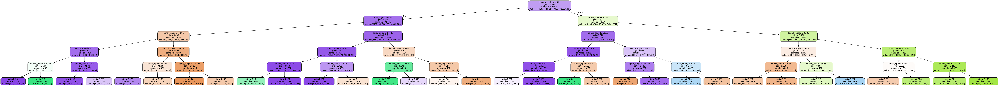

In [26]:
# Visualize the tree trained from complete dataset (optional)
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data, filled=True, rounded=True,special_characters=True, feature_names=X_train.columns)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [27]:
param_grid = {
    "criterion": ["gini", "entropy"],
    "max_depth": [1, 2, 5, 10],
    "min_samples_split": [2, 5, 10, 20]
}

In [28]:
clf=DecisionTreeClassifier()

dt_grid_search = GridSearchCV(clf, param_grid, cv=3, return_train_score=True)
dt_grid_search.fit(X_train, y_train)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=DecisionTreeClassifier(class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features=None,
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              presort=False, random_state=None,
                                              splitter='best'),
             iid='warn', n_jobs=None,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [1, 2, 5, 10],
                        

In [29]:
dt_gs_training_score = np.mean(dt_grid_search.cv_results_['mean_train_score'])
dt_gs_testing_score = dt_grid_search.score(X_train, y_train)

print(f"Mean Training Score: {dt_gs_training_score :.2%}")
print(f"Mean Testing Score: {dt_gs_testing_score :.2%}")
print("Best Parameter Combination Found During Grid Search:")

Mean Training Score: 77.55%
Mean Testing Score: 87.39%
Best Parameter Combination Found During Grid Search:


In [30]:
dt_grid_search.best_params_

{'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 20}

In [31]:
clf=DecisionTreeClassifier(criterion='entropy', max_depth=10, min_samples_split = 20)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

In [32]:
acc = accuracy_score(y_test,y_pred) * 100
print("Accuracy is :{0}".format(acc))
# Check the AUC for predictions
# Create and print a confusion matrix 
print('\nConfusion Matrix')
print('----------------')
print(pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted'], margins=True))

Accuracy is :83.34534967555875

Confusion Matrix
----------------
Predicted  double  home_run  sac_bunt  sac_fly  single  triple   All
True                                                                
double       1196       208         0       31     456      17  1908
home_run      139      1263         0       13       8       7  1430
sac_bunt        0         0       162        0      18       0   180
sac_fly        56        48         0      106      37       2   249
single        349        17        12        9    5364       7  5758
triple        101        40         0        2      40       1   184
All          1841      1576       174      161    5923      34  9709


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.424481 to fit



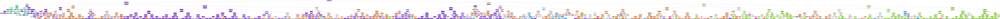

In [33]:
# Visualize the tree trained from complete dataset (optional)
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data, filled=True, rounded=True,special_characters=True, feature_names=X_train.columns)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

# Use SMOTE to Correct Imbalance

In [34]:
print(y_train.value_counts()) #Previous original class distribution
smote = SMOTE()
X_train_smote, y_train_smote = smote.fit_sample(X_train, y_train) 
print(pd.Series(y_train_smote).value_counts()) #Preview synthetic sample class distributi

single      17285
double       5631
home_run     4421
sac_fly       743
triple        523
sac_bunt      521
Name: events, dtype: int64
sac_bunt    17285
sac_fly     17285
double      17285
triple      17285
single      17285
home_run    17285
dtype: int64


In [35]:
clf=DecisionTreeClassifier(criterion='entropy', max_depth=10, min_samples_split = 20)
clf.fit(X_train_smote, y_train_smote)
y_pred = clf.predict(X_test)

In [36]:
acc = accuracy_score(y_test,y_pred) * 100
print("Accuracy is :{0}".format(acc))
# Check the AUC for predictions
# Create and print a confusion matrix 
print('\nConfusion Matrix')
print('----------------')
print(pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted'], margins=True))

Accuracy is :77.20671541868369

Confusion Matrix
----------------
Predicted  double  home_run  sac_bunt  sac_fly  single  triple   All
True                                                                
double        917       159         0       91     382     359  1908
home_run       88      1095         0       61       2     184  1430
sac_bunt        0         0       173        0       7       0   180
sac_fly        18        11         0      179      16      25   249
single        379        22        20      118    5070     149  5758
triple         52        23         0       12      35      62   184
All          1454      1310       193      461    5512     779  9709


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.325965 to fit



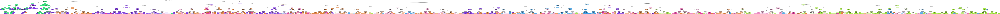

In [37]:
# Visualize the tree trained from complete dataset (optional)
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data, filled=True, rounded=True,special_characters=True, feature_names=X_train.columns)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [38]:
# Scale Training Data

scaler = StandardScaler()
scaled_data_train = scaler.fit_transform(X_train_smote)
scaled_data_test = scaler.transform(X_test)

In [39]:
scaled_data_train

array([[ 0.85183432,  1.35605436, -0.22078764, ..., -0.61457824,
         0.41221036, -0.41127397],
       [ 0.54374293, -0.83787422,  0.05319137, ..., -0.61457824,
         0.41221036, -0.41127397],
       [-1.55512964, -1.15733193, -0.07222156, ..., -0.61457824,
         0.41221036, -0.41127397],
       ...,
       [ 0.19582396,  1.85213351,  0.43907001, ..., -0.61457824,
         0.41221036, -0.41127397],
       [ 0.85189448, -0.34342326,  1.14240868, ..., -0.61457824,
         0.41221036, -0.41127397],
       [ 0.90308527, -0.48049855,  1.10263558, ..., -0.61457824,
         0.41221036, -0.41127397]])

In [40]:
clf=DecisionTreeClassifier(criterion='entropy', max_depth=10, min_samples_split = 20)
clf.fit(scaled_data_train, y_train_smote)
y_pred = clf.predict(scaled_data_test)

In [41]:
acc = accuracy_score(y_test,y_pred) * 100
print("Accuracy is :{0}".format(acc))
# Check the AUC for predictions
# Create and print a confusion matrix 
print('\nConfusion Matrix')
print('----------------')
print(pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted'], margins=True))

Accuracy is :77.2273148624987

Confusion Matrix
----------------
Predicted  double  home_run  sac_bunt  sac_fly  single  triple   All
True                                                                
double        917       159         0       90     382     360  1908
home_run       87      1096         0       61       2     184  1430
sac_bunt        0         0       172        0       8       0   180
sac_fly        18        11         0      179      16      25   249
single        378        22        19      118    5072     149  5758
triple         52        23         0       12      35      62   184
All          1452      1311       191      460    5515     780  9709


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.326209 to fit



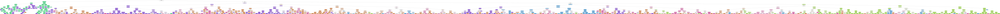

In [42]:
# Visualize the tree trained from complete dataset (optional)
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data, filled=True, rounded=True,special_characters=True, feature_names=X_train.columns)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [43]:
scaler = MinMaxScaler()
scaled_data_train = scaler.fit_transform(X_train_smote)
scaled_data_test = scaler.transform(X_test)

In [44]:
scaled_data_train

array([[0.8161157 , 0.67303738, 0.78084543, ..., 0.        , 1.        ,
        0.        ],
       [0.78305785, 0.28017015, 0.79873689, ..., 0.        , 1.        ,
        0.        ],
       [0.55785124, 0.2229648 , 0.79054714, ..., 0.        , 1.        ,
        0.        ],
       ...,
       [0.74572655, 0.76187037, 0.82393564, ..., 0.        , 1.        ,
        0.        ],
       [0.81612216, 0.36871159, 0.86986526, ..., 0.        , 1.        ,
        0.        ],
       [0.82161487, 0.34416549, 0.86726799, ..., 0.        , 1.        ,
        0.        ]])

In [45]:
clf=DecisionTreeClassifier(criterion='entropy', max_depth=10, min_samples_split = 20)
clf.fit(scaled_data_train, y_train_smote)
y_pred = clf.predict(scaled_data_test)

In [46]:
acc = accuracy_score(y_test,y_pred) * 100
print("Accuracy is :{0}".format(acc))
# Check the AUC for predictions
# Create and print a confusion matrix 
print('\nConfusion Matrix')
print('----------------')
print(pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted'], margins=True))

Accuracy is :77.26851375012875

Confusion Matrix
----------------
Predicted  double  home_run  sac_bunt  sac_fly  single  triple   All
True                                                                
double        915       159         0       91     383     360  1908
home_run       87      1096         0       61       2     184  1430
sac_bunt        0         0       173        0       7       0   180
sac_fly        18        11         0      179      16      25   249
single        372        22        19      118    5077     150  5758
triple         52        23         0       12      35      62   184
All          1444      1311       192      461    5520     781  9709


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.326794 to fit



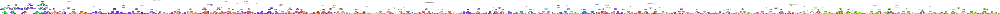

In [47]:
# Visualize the tree trained from complete dataset (optional)
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data, filled=True, rounded=True,special_characters=True, feature_names=X_train.columns)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

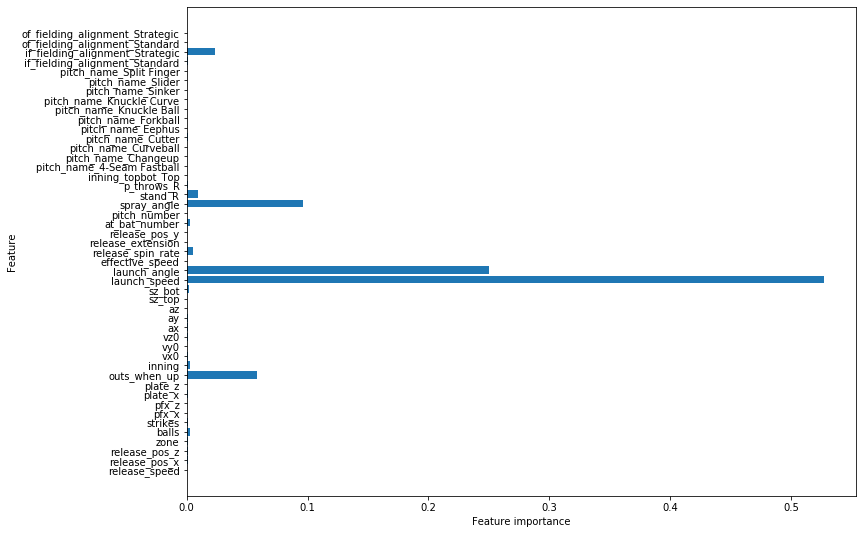

In [48]:
def plot_feature_importances(model):
    n_features = X_train.shape[1]
    plt.figure(figsize=(12,9))
    plt.barh(range(n_features), model.feature_importances_, align='center') 
    plt.yticks(np.arange(n_features), X_train.columns.values) 
    plt.xlabel("Feature importance")
    plt.ylabel("Feature")

plot_feature_importances(clf)

# Random Forest

In [49]:
forest = RandomForestClassifier(n_estimators=100, max_depth= 5)
forest.fit(scaled_data_train, y_train_smote)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
                       max_depth=5, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [50]:
print(forest.score(scaled_data_train, y_train_smote))
print(forest.score(scaled_data_test, y_test))

0.7301513836659917
0.7266453805747245


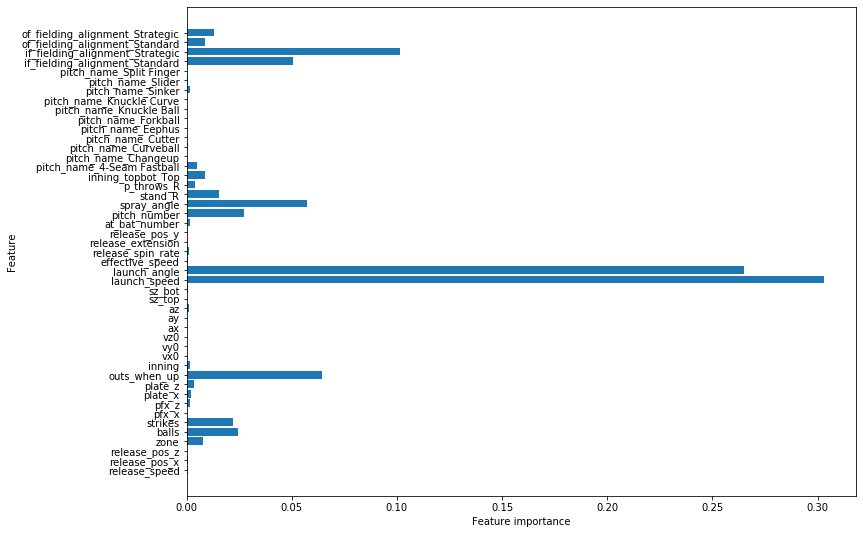

In [51]:
plot_feature_importances(forest)

In [52]:
print('\nConfusion Matrix')
print('----------------')
print(pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted'], margins=True, normalize=True))


Confusion Matrix
----------------
Predicted    double  home_run  sac_bunt   sac_fly    single    triple  \
True                                                                    
double     0.094242  0.016377  0.000000  0.009373  0.039448  0.037079   
home_run   0.008961  0.112885  0.000000  0.006283  0.000206  0.018951   
sac_bunt   0.000000  0.000000  0.017819  0.000000  0.000721  0.000000   
sac_fly    0.001854  0.001133  0.000000  0.018437  0.001648  0.002575   
single     0.038315  0.002266  0.001957  0.012154  0.522917  0.015450   
triple     0.005356  0.002369  0.000000  0.001236  0.003605  0.006386   
All        0.148728  0.135029  0.019775  0.047482  0.568545  0.080441   

Predicted       All  
True                 
double     0.196519  
home_run   0.147286  
sac_bunt   0.018539  
sac_fly    0.025646  
single     0.593058  
triple     0.018951  
All        1.000000  


In [53]:
param_grid = {
    "criterion": ["gini", "entropy"],
    "max_depth": [5, 10],
    "min_samples_split": [2, 5, 10]
}

In [54]:
forest=RandomForestClassifier()

rf_grid_search = GridSearchCV(forest, param_grid, cv=3, return_train_score=True)
rf_grid_search.fit(X_train_smote, y_train_smote)

rf_gs_training_score = np.mean(dt_grid_search.cv_results_['mean_train_score'])
rf_gs_testing_score = dt_grid_search.score(X_train_smote, y_train_smote)

print(f"Mean Training Score: {dt_gs_training_score :.2%}")
print(f"Mean Testing Score: {dt_gs_testing_score :.2%}")
print("Best Parameter Combination Found During Grid Search:")
rf_grid_search.best_params_

Mean Training Score: 77.55%
Mean Testing Score: 87.39%
Best Parameter Combination Found During Grid Search:


{'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 10}

0.8483849194870311
0.7881347203625502


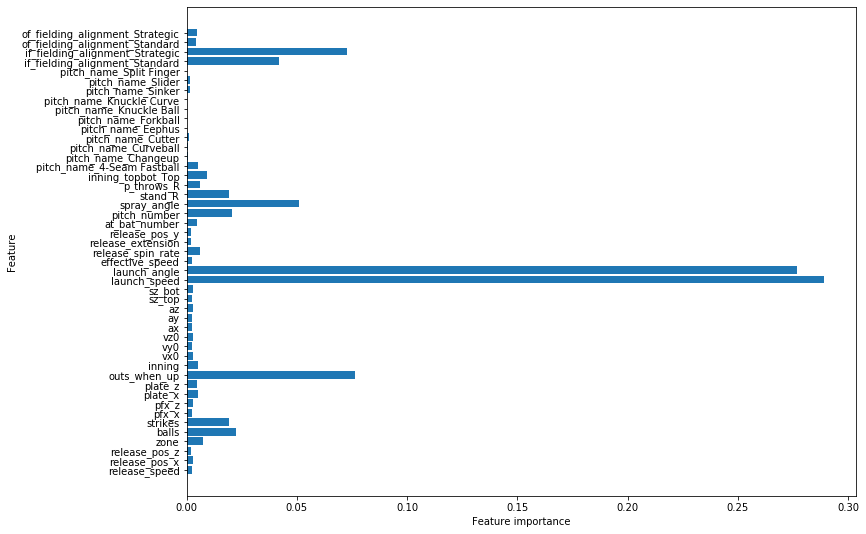

In [55]:
forest = RandomForestClassifier(n_estimators=100, max_depth= 10, min_samples_split=2, criterion='entropy')
forest.fit(scaled_data_train, y_train_smote)
print(forest.score(scaled_data_train, y_train_smote))
print(forest.score(scaled_data_test, y_test))
plot_feature_importances(forest)

# KNN

In [56]:
clf1 = KNeighborsClassifier()
clf1.fit(scaled_data_train, y_train_smote)
test_preds = clf1.predict(scaled_data_test)

In [57]:
def print_metrics(labels, preds):
    print("Accuracy Score: {}".format(accuracy_score(labels, preds)))
    
print_metrics(y_test, test_preds)

Accuracy Score: 0.39767226284890306


In [58]:
print('\nConfusion Matrix')
print('----------------')
print(pd.crosstab(y_test, test_preds, rownames=['True'], colnames=['Predicted'], margins=True))


Confusion Matrix
----------------
Predicted  double  home_run  sac_bunt  sac_fly  single  triple   All
True                                                                
double        573       484         2      122     622     105  1908
home_run      413       495         2      102     329      89  1430
sac_bunt        5         1       143        6      22       3   180
sac_fly        64        61         1       48      56      19   249
single       1446       942        59      405    2590     316  5758
triple         44        55         0       14      59      12   184
All          2545      2038       207      697    3678     544  9709


In [59]:
def find_best_k(X_train, y_train, X_test, y_test, min_k=3, max_k=5):
    best_k = 0
    best_score = 0.0
    for k in range(min_k, max_k+1, 2):
        knn = KNeighborsClassifier(n_neighbors=k)
        knn.fit(X_train, y_train)
        preds = knn.predict(X_test)
        acc = accuracy_score(y_test, preds)
        if acc > best_score:
            best_k = k
            best_score = acc
    
    print("Best Value for k: {}".format(best_k))
    print("Accuracy Score: {}".format(best_score))

In [60]:
find_best_k(scaled_data_train, y_train_smote, scaled_data_test, y_test, min_k=3, max_k=5)

Best Value for k: 3
Accuracy Score: 0.42373055927489955


# Gradient Boost

In [61]:
adaboost_clf = AdaBoostClassifier()
gbt_clf = GradientBoostingClassifier()

In [62]:
adaboost_clf.fit(scaled_data_train, y_train_smote)

gbt_clf.fit(scaled_data_train, y_train_smote)

GradientBoostingClassifier(criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='auto',
                           random_state=None, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [63]:
adaboost_scaled_train_preds = adaboost_clf.predict(scaled_data_train)
adaboost_scaled_test_preds = adaboost_clf.predict(scaled_data_test)
gbt_clf_scaled_train_preds = gbt_clf.predict(scaled_data_train)
gbt_clf_scaled_test_preds = gbt_clf.predict(scaled_data_test)

In [64]:
def display_acc(true, preds, model_name):
    acc = accuracy_score(true, preds)
#     f1 = f1_score(true, preds)
    print("Model: {}".format(model_name))
    print("Accuracy: {}".format(acc))
#     print("F1-Score: {}".format(f1))
    
print("Training Metrics")
display_acc(y_train_smote, adaboost_scaled_train_preds, model_name='AdaBoost')
print("")
display_acc(y_train_smote, gbt_clf_scaled_train_preds, model_name='Gradient Boosted Trees')
print("")
print("Testing Metrics")
display_acc(y_test, adaboost_scaled_test_preds, model_name='AdaBoost')
print("")
display_acc(y_test, gbt_clf_scaled_test_preds, model_name='Gradient Boosted Trees')

Training Metrics
Model: AdaBoost
Accuracy: 0.4669752193616816

Model: Gradient Boosted Trees
Accuracy: 0.8542474206923151

Testing Metrics
Model: AdaBoost
Accuracy: 0.45741064991245234

Model: Gradient Boosted Trees
Accuracy: 0.8377793799567411


# XG Boost

In [65]:
clf = xgb.XGBClassifier()
clf.fit(scaled_data_train, y_train_smote)
training_preds = clf.predict(scaled_data_train)
val_preds = clf.predict(scaled_data_test)
training_accuracy = accuracy_score(y_train_smote, training_preds)
val_accuracy = accuracy_score(y_test, val_preds)

print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
print("Validation accuracy: {:.4}%".format(val_accuracy * 100))

Training Accuracy: 83.36%
Validation accuracy: 82.85%


In [66]:
param_grid = {
    "learning_rate": [0.1],
    'max_depth': [5, 10],
    'min_child_weight': [10],
    'subsample': [ 0.7],
    'n_estimators': [100],
}

In [67]:
# grid_clf = GridSearchCV(clf, param_grid, scoring='accuracy', cv=5, n_jobs=1)
# grid_clf.fit(scaled_data_train, y_train_smote)

# best_parameters = grid_clf.best_params_

# print("Grid Search found the following optimal parameters: ")
# for param_name in sorted(best_parameters.keys()):
#     print("%s: %r" % (param_name, best_parameters[param_name]))

# training_preds = grid_clf.predict(scaled_data_train)
# val_preds = grid_clf.predict(scaled_data_test)
# training_accuracy = accuracy_score(y_train_smote, training_preds)
# val_accuracy = accuracy_score(y_test, val_preds)

# print("")
# print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
# print("Validation accuracy: {:.4}%".format(val_accuracy * 100))

In [68]:
print('\nConfusion Matrix')
print('----------------')
print(pd.crosstab(y_test, val_preds, rownames=['True'], colnames=['Predicted'], margins=True))


Confusion Matrix
----------------
Predicted  double  home_run  sac_bunt  sac_fly  single  triple   All
True                                                                
double       1045       214         0      122     427     100  1908
home_run       70      1265         0       65       1      29  1430
sac_bunt        0         0       176        0       4       0   180
sac_fly        14        15         0      191      20       9   249
single        276        23        27       60    5343      29  5758
triple         58        42         0       19      41      24   184
All          1463      1559       203      457    5836     191  9709


In [69]:
print('\nConfusion Matrix')
print('----------------')
print(pd.crosstab(y_test, val_preds, rownames=['True'], colnames=['Predicted'], margins=True, normalize=True))


Confusion Matrix
----------------
Predicted    double  home_run  sac_bunt   sac_fly    single    triple  \
True                                                                    
double     0.107632  0.022041  0.000000  0.012566  0.043980  0.010300   
home_run   0.007210  0.130291  0.000000  0.006695  0.000103  0.002987   
sac_bunt   0.000000  0.000000  0.018128  0.000000  0.000412  0.000000   
sac_fly    0.001442  0.001545  0.000000  0.019672  0.002060  0.000927   
single     0.028427  0.002369  0.002781  0.006180  0.550314  0.002987   
triple     0.005974  0.004326  0.000000  0.001957  0.004223  0.002472   
All        0.150685  0.160573  0.020908  0.047070  0.601092  0.019672   

Predicted       All  
True                 
double     0.196519  
home_run   0.147286  
sac_bunt   0.018539  
sac_fly    0.025646  
single     0.593058  
triple     0.018951  
All        1.000000  


# Accuracy Visualization

In [70]:
X_test['y_pred'] = val_preds

In [71]:
X_test['y_test'] = y_test

In [72]:
X_test_viz_df = X_test[['y_pred', 'y_test', 'launch_angle', 'launch_speed']]

In [73]:
X_test_viz_df.head()

,y_pred,y_test,launch_angle,launch_speed
12393,single,single,6.5,90.7
2535,home_run,single,20.8,104.9
36581,single,single,4.0,100.7
28306,single,single,-49.7,63.8
33718,single,single,13.7,94.9


In [74]:
X_test_viz_df["correct"] = np.where(X_test_viz_df.y_pred == X_test_viz_df.y_test, 'True', 'False')

In [130]:
fig = px.scatter(X_test_viz_df[:], x="launch_speed", y="launch_angle", log_x=False, log_y = False, hover_name="y_test",
                hover_data = ['y_pred'], color="correct")

fig.show()

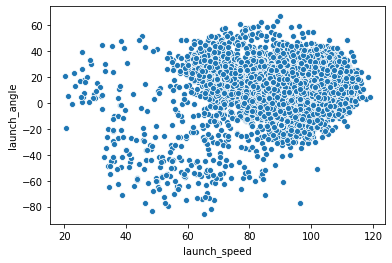

In [135]:
sns.scatterplot(x="launch_speed", y="launch_angle", data=X_test_viz_df[:])

In [94]:
events = ['single',  'double',  'triple',  'home_run',  'sac_bunt',  'sac_fly']

In [95]:
events

['single', 'double', 'triple', 'home_run', 'sac_bunt', 'sac_fly']

Confusion matrix, without normalization
[[5343  276   29   23   27   60]
 [ 427 1045  100  214    0  122]
 [  41   58   24   42    0   19]
 [   1   70   29 1265    0   65]
 [   4    0    0    0  176    0]
 [  20   14    9   15    0  191]]
Normalized confusion matrix
[[9.28e-01 4.79e-02 5.04e-03 3.99e-03 4.69e-03 1.04e-02]
 [2.24e-01 5.48e-01 5.24e-02 1.12e-01 0.00e+00 6.39e-02]
 [2.23e-01 3.15e-01 1.30e-01 2.28e-01 0.00e+00 1.03e-01]
 [6.99e-04 4.90e-02 2.03e-02 8.85e-01 0.00e+00 4.55e-02]
 [2.22e-02 0.00e+00 0.00e+00 0.00e+00 9.78e-01 0.00e+00]
 [8.03e-02 5.62e-02 3.61e-02 6.02e-02 0.00e+00 7.67e-01]]


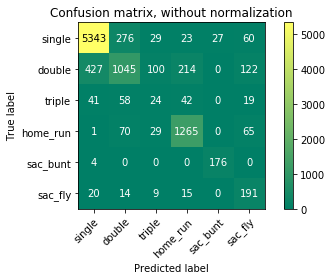

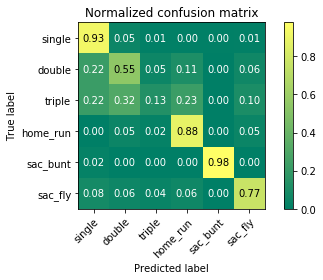

In [100]:
def plot_confusion_matrix(y_true, y_pred, classes,
                         normalize=False,
                         title=None,
                         cmap=plt.cm.summer):
   """
   This function prints and plots the confusion matrix.
   Normalization can be applied by setting normalize=True.
   """
   if not title:
       if normalize:
           title = 'Normalized confusion matrix'
       else:
           title = 'Confusion matrix, without normalization'
   # Compute confusion matrix
   cm = confusion_matrix(y_true, y_pred, labels=events)
   # Only use the labels that appear in the data
   if normalize:
       cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
       print("Normalized confusion matrix")
   else:
       print('Confusion matrix, without normalization')
   print(cm)
   fig, ax = plt.subplots()
   im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
   ax.figure.colorbar(im, ax=ax)
   # We want to show all ticks...
   ax.set(xticks=np.arange(cm.shape[1]),
          yticks=np.arange(cm.shape[0]),
          # ... and label them with the respective list entries
          xticklabels=classes, yticklabels=classes,
          title=title,
          ylabel='True label',
          xlabel='Predicted label')
   # Rotate the tick labels and set their alignment.
   plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
            rotation_mode="anchor")
   # Loop over data dimensions and create text annotations.
   fmt = '.2f' if normalize else 'd'
   thresh = cm.max() / 2.
   for i in range(cm.shape[0]):
       for j in range(cm.shape[1]):
           ax.text(j, i, format(cm[i, j], fmt),
                   ha="center", va="center",
                   color="black" if cm[i, j] > thresh else "white")
   fig.tight_layout()
   return ax
np.set_printoptions(precision=2)
# Plot non-normalized confusion matrix
plot_confusion_matrix(y_test, val_preds, classes=events,
                     title='Confusion matrix, without normalization')
# Plot normalized confusion matrix
plot_confusion_matrix(y_test, val_preds, classes=events, normalize=True,
                     title='Normalized confusion matrix')